In [9]:
from lib.notebook_imports import *

pd.set_option('display.max_columns', 10)
pd.set_option('display.max_rows', 10)
pd.set_option('display.max_colwidth', None)

%load_ext autoreload
%autoreload 2

shap.initjs()

start_time = datetime.now()


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# READ DATA 900

In [2]:
from dotenv import load_dotenv
load_dotenv()
DATA_PATH = os.environ.get("DATA_PATH")

In [3]:
data_900 = read_data(DATA_PATH, merge_with_meds=True, merge_with_patient_genes=True)
data_900_df = data_900.input_df

LGB_PARAMS_BASE, N_FOLDS, ALL_MODEL_SUFFIXES, BASE_COLS_1, BASE_COLS_2, ranking_cols = get_consts()


Converting ds_1_result_num_E2 to float
Converting ds_1_result_num_LH to float
Converting ds_1_result_num_PRG to float
Converting ds_1_result_num_AMH to float
Converting ds_789_result_num_E2 to float
Converting amh_qual_result_num to float
Converting qual_result_num_FSH to float
Converting qual_result_num_DHEAS to float
Converting qual_result_num_Inh_B to float
Converting qual_result_num_TST to float
Converting qual_result_num_anty_TPO to float
Converting qual_result_num_TSH to float
Converting qual_result_num_SHBG to float
weight    0.503356
height    0.492170
bmi       0.460850
dtype: float64
pickups_df:                  981
merged with meds_df:         936
merged with patient_gens_df: 922
merged with poli_changes_df: 922
merged with causes_df: 922
merged with patient_groups_df: 922
merged with body_df: 922

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retu

# READ VCF FILES

In [4]:
genetic_data = read_vcf_files(
    DATA_PATH,
    DATA_PATH+"/vcf/",
)

gt1='AT')
1
Genome(gt0='G', gt1='C')
1
Genome(gt0='A', gt1='G')
1
Genome(gt0='T', gt1='C')
1
Genome(gt0='T', gt1='T')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='A', gt1='A')
1
Genome(gt0='A', gt1='A')
1
Genome(gt0='A', gt1='G')
1
Genome(gt0='T', gt1='A')
1
Genome(gt0='C', gt1='T')
1
Genome(gt0='G', gt1='A')
1
Genome(gt0='T', gt1='C')
1
Genome(gt0='A', gt1='G')
1
Genome(gt0='A', gt1='G')
1
Genome(gt0='T', gt1='C')
1
Genome(gt0='T', gt1='C')
1
Genome(gt0='A', gt1='C')
1
Genome(gt0='A', gt1='A')
1
Genome(gt0='G', gt1='T')
1
Genome(gt0='G', gt1='A')
1
Genome(gt0='A', gt1='A')
1
Genome(gt0='C', gt1='C')
1
Genome(gt0='C', gt1='C')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='C', gt1='C')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='C', gt1='C')
1
Genome(gt0='C', gt1='C')
1
Genome(gt0='T', gt1='T')
1
Genome(gt0='A', gt1='G')
1
Genome(gt0='C', gt1='A')
1
Genome(gt0='G', gt1='G')
1
Genome(gt0='A', gt1='ACACACAC')
1
Genome(gt0='C', gt1='C')
1
Genome(gt

# MERGE GENETIC_DATA WITH DATA_900_DF

In [5]:
genome_df, genome_012_cols, hetero_cols, homo_cols, has_alt_cols = prepare_genome_df(genetic_data)

In [8]:
print(len(data_900_df['__id__'].unique()))
print(len(genome_df['patient_id'].unique()))

436
445


In [6]:
print(f'before merge: {len(data_900_df)}')
data_900_df = data_900_df.merge(genome_df, left_on='__id__', right_on='patient_id', how='inner')
print(f'after merge:  {len(data_900_df)}')

before merge: 922
after merge:  914


# READ HAPLOVIEW RESULTS

In [7]:
chromosomes = [
    "chr11",
    "chr12",
    "chr14",
    "chr17",
    "chr19",
    "chr2",
    "chr5",
    "chr6",
    "chrX",
]
methods = ['GABRIEL', '4GAM', 'SPINE']

In [13]:
data_900_df, all_block_cols = read_haploview_data(
    DATA_PATH +"/poprawne_vcf_haplotypes/haplotypes/hmap", chromosomes, methods, data_900_df)

In [14]:
gabriel_cols = [col for col in all_block_cols if 'GABRIEL' in col and 'NONE' not in col]
fourgam_cols = [col for col in all_block_cols if '4GAM' in col and 'NONE' not in col]
spine_cols = [col for col in all_block_cols if 'SPINE' in col and 'NONE' not in col]


# PREPARE DATA SERIES

In [15]:
DATA_SERIES_900 = {}
DATA_SERIES_900['900_cumulus_denuded'] = prepare_data_serie(data_900_df, 'cumulus_denuded', N_FOLDS)
DATA_SERIES_900['900_day_0_mii'] = prepare_data_serie(data_900_df, 'day_0_mii', N_FOLDS)

Original records: 914
Removed records:  260
Removed records:  0
Removed records:  0
Removed records:  14
Removed records:  92
Removed records:  18
Filtered records: 530
Original records: 914
Removed records:  260
Removed records:  0
Removed records:  0
Removed records:  30
Removed records:  90
Removed records:  18
Filtered records: 516


# BASE EXPERIMENTS

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[ test_fold_av

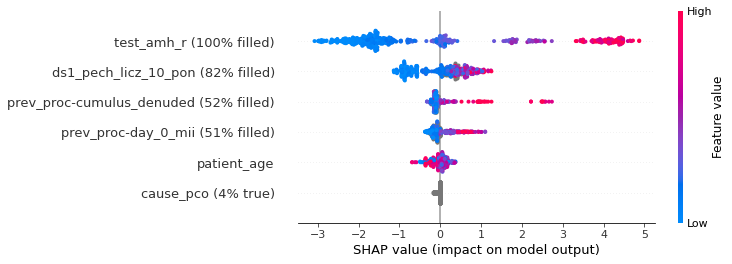

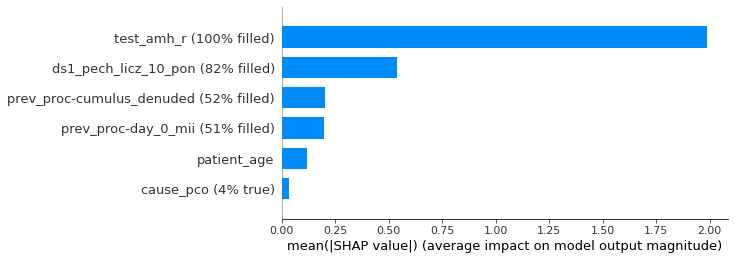

In [16]:
REF_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco"
]
REF_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    REF_COLS,
    model_suffixes_filter=['l2'])
REF_RESULTS.print_errors(
    [REF_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
shap_vals,all_train_dfs = explain_model(
    REF_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))
REF_RESULTS_df = REF_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
REF_RESULTS_df['error'] = REF_RESULTS_df['day_0_mii']-REF_RESULTS_df['prediction_l2']

# CALCULATE PROC_DF, PATIENTS_DF

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[ test_fold_av

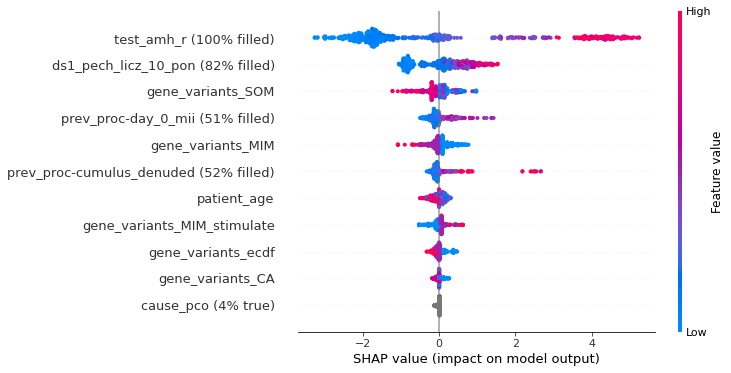

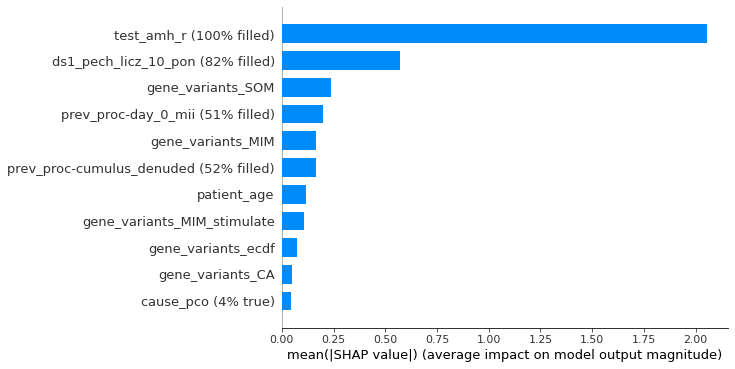

In [18]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",         
    'gene_variants_ecdf',
    'gene_variants_SOM',
    'gene_variants_MIM_stimulate',
    'gene_variants_MIM',
    'gene_variants_CA'
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
shap_vals,all_train_dfs = explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
GENE_RESULTS_df['error'] = GENE_RESULTS_df['day_0_mii']-GENE_RESULTS_df['prediction_l2']

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[ test_fold_av

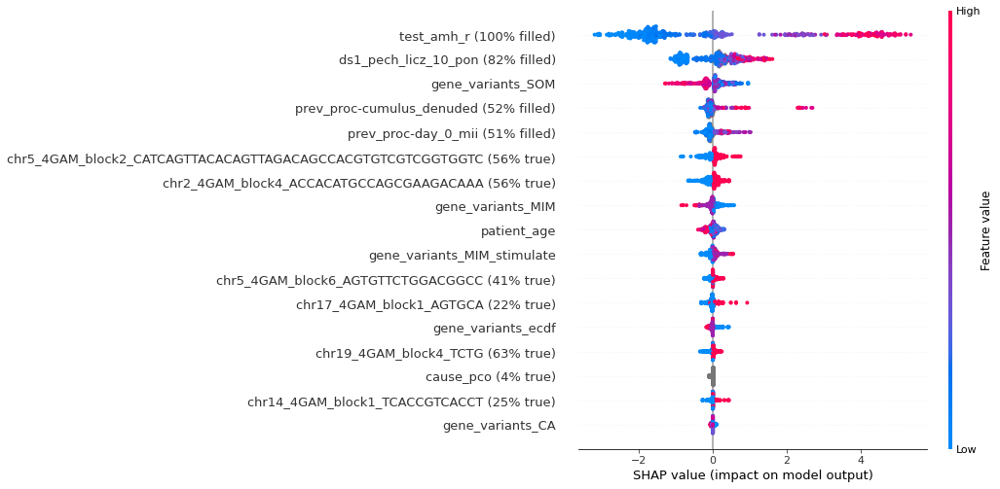

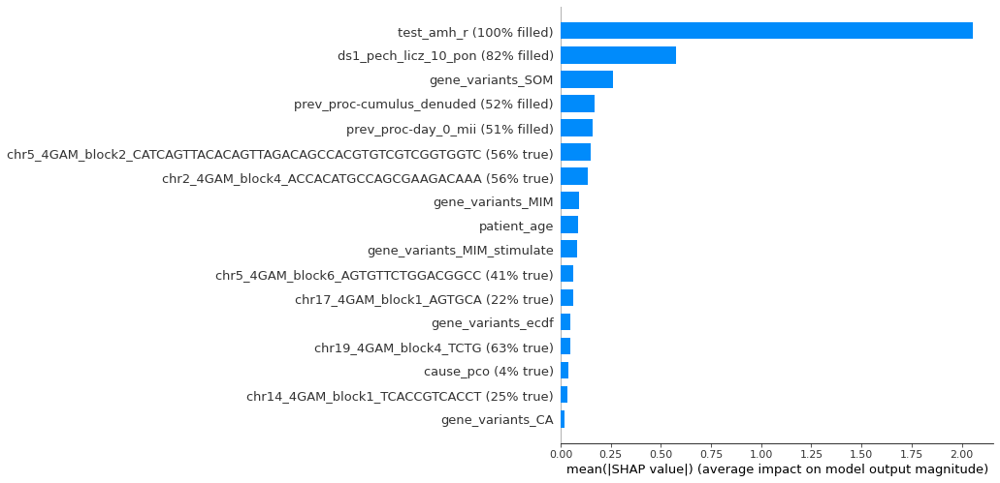

In [32]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",         
    'gene_variants_ecdf',
    'gene_variants_SOM',
    'gene_variants_MIM_stimulate',
    'gene_variants_MIM',
    'gene_variants_CA',
    "chr14_4GAM_block1_TCACCGTCACCT", "chr17_4GAM_block1_AGTGCA", "chr19_4GAM_block4_TCTG", "chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA",      "chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC", "chr5_4GAM_block6_AGTGTTCTGGACGGCC"
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
shap_vals,all_train_dfs = explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
GENE_RESULTS_df['error'] = GENE_RESULTS_df['day_0_mii']-GENE_RESULTS_df['prediction_l2']


In [106]:
# FILTER PROC_DF AS IN LEARING

proc_df = DATA_SERIES_900['900_day_0_mii'].input_df.copy()
len(proc_df)

516

In [107]:
# FILTER PROC_PATIENTS_DF AS IN LEARNING

proc_patients_df = proc_df[genetic_cols].drop_duplicates()
print(len(proc_patients_df))

264


In [108]:
# FILTER DAWKJ FROM DATA_900_DF

dawkj_df = data_900_df[data_900_df['process_type'] == 'DAWKJ'][genetic_cols].drop_duplicates()
print(len(dawkj_df))

113


# CALCULATE P-VALUES FOR HAPLOTYPES

In [146]:
print(len(gabriel_cols))
print(len(fourgam_cols))
print(len(spine_cols))
print(len(genome_012_cols))
print(len(has_alt_cols))
print(len(hetero_cols))
print(len(homo_cols))


55
143
113
633
633
633
633


In [147]:
%%time
gabriel_p_value_df = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(gabriel_cols, 1, 1),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 55
# ETA: 0:00:39


55it [00:34,  1.62it/s]


,p_value,proc_percent_true,proc_number_true,proc_patients_percent_true,proc_patients_number_true,dawkj_patients_percent_true,dawkj_patients_number_true,target_true_mean,target_false_mean,is_interesting
['chr2_GABRIEL_block1_ATC'],0.002000,18.800000,97,18.560000,49,19.470000,22,7.185567,5.627685,False
['chr12_GABRIEL_block1_GG'],0.009000,44.190000,228,42.800000,113,34.510000,39,6.451754,5.500000,False
['chr19_GABRIEL_block4_TCT'],0.015000,62.980000,325,63.640000,168,62.830000,71,6.252308,5.356021,False
['chr17_GABRIEL_block1_TC'],0.029000,22.480000,116,23.110000,61,22.120000,25,6.612069,5.720000,False
['chr6_GABRIEL_block2_GA'],0.033000,81.010000,418,82.580000,218,74.340000,84,6.145933,4.959184,False
['chr19_GABRIEL_block3_GGCAA'],0.035000,59.880000,309,62.500000,165,61.060000,69,6.236246,5.449275,False
['chr19_GABRIEL_block2_CGG'],0.047000,63.570000,328,64.390000,170,61.950000,70,6.185976,5.457447,False
['chrX_GABRIEL_block1_CG'],0.095000,2.710000,14,3.410000,9,0.000000,0,8.071429,5.860558,False
['chr14_GABRIEL_block1_AT'],0.097000,43.800000,226,42.800000,113,49.560000,56,6.212389,5.693103,False
['chr19_GABRIEL_block1_TG'],0.101000,84.110000,434,85.610000,226,81.420000,92,6.036866,5.304878,False


CPU times: user 34.1 s, sys: 120 ms, total: 34.2 s
Wall time: 34.1 s


In [148]:
%%time
fourgam_p_value_df = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(fourgam_cols, 1, 1),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 143
# ETA: 0:01:42


143it [01:28,  1.62it/s]


,p_value,proc_percent_true,proc_number_true,proc_patients_percent_true,proc_patients_number_true,dawkj_patients_percent_true,dawkj_patients_number_true,target_true_mean,target_false_mean,is_interesting
['chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA'],0.000000,56.400000,291,56.440000,149,72.570000,82,6.542955,5.115556,False
['chr2_4GAM_block3_ATTC'],0.001000,18.800000,97,18.560000,49,19.470000,22,7.185567,5.627685,False
['chr14_4GAM_block1_TCACCGTCACCT'],0.004000,24.610000,127,26.140000,69,18.580000,21,6.905512,5.598972,False
['chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC'],0.005000,55.620000,287,54.550000,144,48.670000,55,6.376307,5.349345,False
['chr6_4GAM_block1_ACGTAAGGACG'],0.005000,4.460000,23,4.550000,12,1.770000,2,8.956522,5.778905,False
['chr12_4GAM_block1_GGT'],0.006000,44.190000,228,42.800000,113,34.510000,39,6.451754,5.500000,False
['chr2_4GAM_block2_GACTCCGTCGTGAGGCGATCAATGCT'],0.007000,5.810000,30,4.170000,11,7.960000,9,8.166667,5.781893,False
['chr19_4GAM_block4_TCTG'],0.015000,62.980000,325,63.640000,168,62.830000,71,6.252308,5.356021,False
['chr12_4GAM_block3_GCATATGCAGAATC'],0.015000,3.290000,17,3.030000,8,0.000000,0,9.176471,5.809619,False
['chr6_4GAM_block1_ACGTAAAGACG'],0.019000,29.460000,152,28.790000,76,41.590000,47,6.513158,5.673077,False


CPU times: user 1min 28s, sys: 474 ms, total: 1min 28s
Wall time: 1min 28s


In [149]:
%%time
spine_p_value_df = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(spine_cols, 1, 1),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 113
# ETA: 0:01:21


113it [01:08,  1.65it/s]


,p_value,proc_percent_true,proc_number_true,proc_patients_percent_true,proc_patients_number_true,dawkj_patients_percent_true,dawkj_patients_number_true,target_true_mean,target_false_mean,is_interesting
['chr6_SPINE_block3_TCGCTGACACCCCAGCCCGTGGCGGAACGGGAACGACGATGTATAGAGCATCACGCTACCGGCACTCGTCTATCGT'],0.000000,0.190000,1,0.380000,1,1.770000,2,1.000000,5.930097,False
['chr6_SPINE_block3_TCACTGACACCCCAGCCCGTGGCGGAACGGGAACGACGATGTATAGAACATCACGCTACCGGTACTCGTCTATCGT'],0.000000,0.190000,1,0.380000,1,0.880000,1,5.000000,5.922330,False
['chr6_SPINE_block3_TCGCTGACACCCCAGCTCGTGGCGGAATAGGAACGACGATGTATAGAACATCACGCTACCGGTACTCGTCTATCGT'],0.000000,0.190000,1,0.380000,1,0.000000,0,14.000000,5.904854,False
['chr2_SPINE_block1_AAATACGACTCCGTCGTGAGGCGATCAATGCCATTCCACCACATGCCAGCGAAGACAAAACGAGTA'],0.000000,0.190000,1,0.380000,1,0.880000,1,2.000000,5.928155,False
['chr5_SPINE_block1_GCGGGGGGTACGTACATGCTGCCATCCATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC'],0.001000,41.860000,216,40.910000,108,34.510000,39,6.777778,5.303333,False
['chr6_SPINE_block1_CGTAAAG'],0.005000,31.980000,165,30.300000,80,41.590000,47,6.630303,5.586895,False
['chr6_SPINE_block1_CGTAAGG'],0.005000,4.460000,23,4.550000,12,1.770000,2,8.956522,5.778905,False
['chr12_SPINE_block1_GGT'],0.006000,44.190000,228,42.800000,113,34.510000,39,6.451754,5.500000,False
['chr5_SPINE_block3_AATGACTCCC'],0.009000,2.130000,11,2.270000,6,1.770000,2,10.909091,5.811881,False
['chr19_SPINE_block4_TCTG'],0.021000,62.980000,325,63.640000,168,62.830000,71,6.252308,5.356021,False


CPU times: user 1min 8s, sys: 224 ms, total: 1min 8s
Wall time: 1min 8s


In [150]:
%%time
has_alt_p_value_df = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(has_alt_cols, 1, 1),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 633
# ETA: 0:07:32


633it [05:00,  2.11it/s]


CPU times: user 5min, sys: 989 ms, total: 5min 1s
Wall time: 5min


# PAIRS

In [151]:
%%time
gabriel_p_value_df_2 = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(gabriel_cols, 2, 2),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 1485
# ETA: 0:17:41


1485it [13:45,  1.80it/s]


CPU times: user 13min 47s, sys: 3.69 s, total: 13min 50s
Wall time: 13min 46s


In [152]:
%%time
fourgam_p_value_df_2 = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(fourgam_cols, 2, 2),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 10153
# ETA: 2:00:52


10153it [1:24:36,  2.00it/s]


CPU times: user 1h 24min 44s, sys: 20.9 s, total: 1h 25min 5s
Wall time: 1h 24min 41s


In [153]:
%%time
spine_p_value_df_2 = calculate_bootstrap_p_value_for_bool_columns(
    proc_df,
    proc_patients_df,
    dawkj_df,
    gen_combinations(spine_cols, 2, 2),
    'day_0_mii',
    1000,
)

0it [00:00, ?it/s]

# Number of column combinations: 6328
# ETA: 1:15:20


6328it [33:09,  3.18it/s]


CPU times: user 33min 12s, sys: 7.64 s, total: 33min 20s
Wall time: 33min 11s


In [215]:
def show_interesting_haplotypes(
        p_value_df: pd.DataFrame,
        proc_df: pd.DataFrame,
        proc_patients_df: pd.DataFrame,
        dawkj_patients_df: pd.DataFrame,
        target_col: str,
        b_count: int,
    ):

    for index, row in p_value_df.sort_values(by='p_value').iterrows():
        
        if not row['is_interesting']:
            continue
        
        columns = eval(index)

        proc_filter_true = np.logical_and.reduce(
            [proc_df[column] for column in columns])
        proc_df_true = proc_df[proc_filter_true]
        proc_df_false = proc_df[~proc_filter_true]

        proc_patients_filter_true = np.logical_and.reduce(
            [proc_patients_df[column] for column in columns])
        proc_patients_df_true = proc_patients_df[proc_patients_filter_true]
        proc_patients_df_false = proc_patients_df[~proc_patients_filter_true]

        dawkj_patients_filter_true = np.logical_and.reduce(
            [dawkj_patients_df[column] for column in columns])
        dawkj_patients_df_true = dawkj_patients_df[dawkj_patients_filter_true]
        dawkj_patients_df_false = dawkj_patients_df[~dawkj_patients_filter_true]

        
        IN_GROUP = 'IN GROUP'
        OUTSIDE_GROUP = 'OUTSIDE GROUP'
        
        case_dict = {}
        case_dict['haplotype'] = {
            IN_GROUP: index,
            OUTSIDE_GROUP: f'not {index}',
        }
        case_dict['p_value'] = {
            IN_GROUP: calculate_bootstrap_p_value(
                list(proc_df_true[target_col]),
                list(proc_df_false[target_col]),
                b_count,
            ),
            OUTSIDE_GROUP: calculate_bootstrap_p_value(
                list(proc_df_false[target_col]),
                list(proc_df_true[target_col]),
                b_count,
            ),
        }
        case_dict['liczba procesów'] = {
            IN_GROUP: len(proc_df_true),
            OUTSIDE_GROUP: len(proc_df_false),
        }
        case_dict['liczba pacjentek'] = {
            IN_GROUP: len(proc_patients_df_true),
            OUTSIDE_GROUP: len(proc_patients_df_false),
        }
        case_dict['liczba dawczyń'] = {
            IN_GROUP: len(dawkj_patients_df_true),
            OUTSIDE_GROUP: len(dawkj_patients_df_false),
        }
        case_dict['procent procesów'] = {
            IN_GROUP: round(100 * len(proc_df_true) / len(proc_df)),
            OUTSIDE_GROUP: round(100 * len(proc_df_false) / len(proc_df)),
        }
        case_dict['procent pacjentek'] = {
            IN_GROUP: round(100 * len(proc_patients_df_true) / len(proc_patients_df)),
            OUTSIDE_GROUP: round(100 * len(proc_patients_df_false) / len(proc_patients_df)),
        }
        case_dict['procent dawczyń'] = {
            IN_GROUP: round(100 * len(dawkj_patients_df_true) / len(dawkj_patients_df)),
            OUTSIDE_GROUP: round(100 * len(dawkj_patients_df_false) / len(dawkj_patients_df)),
        }
        case_dict['średnie amh'] = {
            IN_GROUP: proc_df_true['test_amh_r'].mean(),
            OUTSIDE_GROUP: proc_df_false['test_amh_r'].mean(),
        }
        case_dict['średnie ds1_pech_licz_10_pon'] = {
            IN_GROUP: proc_df_true['ds1_pech_licz_10_pon'].mean(),
            OUTSIDE_GROUP: proc_df_false['ds1_pech_licz_10_pon'].mean(),
        }
        case_dict['średnie cumulus_denuded'] = {
            IN_GROUP: proc_df_true['cumulus_denuded'].mean(),
            OUTSIDE_GROUP: proc_df_false['cumulus_denuded'].mean(),
        }
        case_dict['średnie mii'] = {
            IN_GROUP: proc_df_true['day_0_mii'].mean(),
            OUTSIDE_GROUP: proc_df_false['day_0_mii'].mean(),
        }

        case_df = pd.DataFrame.from_dict(case_dict, orient='index')
        display(case_df)


In [ ]:
show_interesting_haplotypes(
    fourgam_p_value_df_2,
    proc_df,
    proc_patients_df,
    dawkj_df,
    'day_0_mii',
    1000,
)

,IN GROUP,OUTSIDE GROUP
haplotype,"['chr2_4GAM_block5_CGAGTACA', 'chr2_4GAM_block3_ATTC']","not ['chr2_4GAM_block5_CGAGTACA', 'chr2_4GAM_block3_ATTC']"
p_value,0,0.998
liczba procesów,55,461
liczba pacjentek,26,238
liczba dawczyń,10,103
procent procesów,11,89
procent pacjentek,10,90
procent dawczyń,9,91
średnie amh,4.46182,3.25451
średnie ds1_pech_licz_10_pon,18.1458,12.7968


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block3_CGCCGGCAACGGC']","not ['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block3_CGCCGGCAACGGC']"
p_value,0,1
liczba procesów,65,451
liczba pacjentek,35,229
liczba dawczyń,12,101
procent procesów,13,87
procent pacjentek,13,87
procent dawczyń,11,89
średnie amh,4.35246,3.2435
średnie ds1_pech_licz_10_pon,15.963,13.0299


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block4_TCTG']","not ['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block4_TCTG']"
p_value,0.001,0.999
liczba procesów,68,448
liczba pacjentek,38,226
liczba dawczyń,14,99
procent procesów,13,87
procent pacjentek,14,86
procent dawczyń,12,88
średnie amh,4.24824,3.2519
średnie ds1_pech_licz_10_pon,16.0357,13.0027


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr17_4GAM_block1_AGTGCA', 'chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC']","not ['chr17_4GAM_block1_AGTGCA', 'chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC']"
p_value,0,1
liczba procesów,69,447
liczba pacjentek,36,228
liczba dawczyń,13,100
procent procesów,13,87
procent pacjentek,14,86
procent dawczyń,12,88
średnie amh,4.6458,3.1883
średnie ds1_pech_licz_10_pon,17.322,12.7686


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr5_4GAM_block6_AGTGTTCTGGACGGCC', 'chr5_4GAM_block1_GCGGGGGGTACGTACATGCTGGGATT']","not ['chr5_4GAM_block6_AGTGTTCTGGACGGCC', 'chr5_4GAM_block1_GCGGGGGGTACGTACATGCTGGGATT']"
p_value,0,0.999
liczba procesów,26,490
liczba pacjentek,14,250
liczba dawczyń,9,104
procent procesów,5,95
procent pacjentek,5,95
procent dawczyń,8,92
średnie amh,3.98731,3.35114
średnie ds1_pech_licz_10_pon,19.15,13.1194


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr5_4GAM_block6_AGTGTTCTGGACGGCC', 'chr5_4GAM_block2_CATCAGCTACATAGTTTGACAGCCACGTGTCGTCGGTGGTC']","not ['chr5_4GAM_block6_AGTGTTCTGGACGGCC', 'chr5_4GAM_block2_CATCAGCTACATAGTTTGACAGCCACGTGTCGTCGGTGGTC']"
p_value,0,1
liczba procesów,29,487
liczba pacjentek,15,249
liczba dawczyń,6,107
procent procesów,6,94
procent pacjentek,6,94
procent dawczyń,5,95
średnie amh,3.78655,3.35918
średnie ds1_pech_licz_10_pon,18,13.1525


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr2_4GAM_block5_CGAGTACA', 'chr6_4GAM_block6_GAACATCAC']","not ['chr2_4GAM_block5_CGAGTACA', 'chr6_4GAM_block6_GAACATCAC']"
p_value,0,1
liczba procesów,49,467
liczba pacjentek,26,238
liczba dawczyń,12,101
procent procesów,9,91
procent pacjentek,10,90
procent dawczyń,11,89
średnie amh,5.55143,3.1557
średnie ds1_pech_licz_10_pon,19.2045,12.7302


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr14_4GAM_block1_TCACCGTCACCT', 'chr19_4GAM_block4_TCTG']","not ['chr14_4GAM_block1_TCACCGTCACCT', 'chr19_4GAM_block4_TCTG']"
p_value,0.001,0.998
liczba procesów,60,456
liczba pacjentek,33,231
liczba dawczyń,10,103
procent procesów,12,88
procent pacjentek,12,88
procent dawczyń,9,91
średnie amh,4.80217,3.19649
średnie ds1_pech_licz_10_pon,16.8605,13.0132


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr17_4GAM_block2_ACTACTTTGGC', 'chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC']","not ['chr17_4GAM_block2_ACTACTTTGGC', 'chr5_4GAM_block2_CATCAGTTACACAGTTAGACAGCCACGTGTCGTCGGTGGTC']"
p_value,0,1
liczba procesów,115,401
liczba pacjentek,61,203
liczba dawczyń,21,92
procent procesów,22,78
procent pacjentek,23,77
procent dawczyń,19,81
średnie amh,3.92783,3.22701
średnie ds1_pech_licz_10_pon,14.9794,12.9354


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr19_4GAM_block2_CGG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']","not ['chr19_4GAM_block2_CGG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']"
p_value,0,1
liczba procesów,191,325
liczba pacjentek,99,165
liczba dawczyń,57,56
procent procesów,37,63
procent pacjentek,38,62
procent dawczyń,50,50
średnie amh,4.06937,2.97994
średnie ds1_pech_licz_10_pon,14.7436,12.6203


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr14_4GAM_block3_CTCCATACCGATCGGTTGCTGCCCGACATTGTTGTTA', 'chr6_4GAM_block3_TCG']","not ['chr14_4GAM_block3_CTCCATACCGATCGGTTGCTGCCCGACATTGTTGTTA', 'chr6_4GAM_block3_TCG']"
p_value,0.003,0.999
liczba procesów,56,460
liczba pacjentek,31,233
liczba dawczyń,11,102
procent procesów,11,89
procent pacjentek,12,88
procent dawczyń,10,90
średnie amh,4.99214,3.18733
średnie ds1_pech_licz_10_pon,16.3902,13.084


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr14_4GAM_block1_TCACCGTCACCT', 'chr2_4GAM_block1_AAATAG']","not ['chr14_4GAM_block1_TCACCGTCACCT', 'chr2_4GAM_block1_AAATAG']"
p_value,0.001,0.995
liczba procesów,39,477
liczba pacjentek,22,242
liczba dawczyń,6,107
procent procesów,8,92
procent pacjentek,8,92
procent dawczyń,5,95
średnie amh,4.61231,3.2827
średnie ds1_pech_licz_10_pon,14.7241,13.3079


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr14_4GAM_block1_TCACCGTCACCT', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']","not ['chr14_4GAM_block1_TCACCGTCACCT', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']"
p_value,0.001,1
liczba procesów,58,458
liczba pacjentek,28,236
liczba dawczyń,12,101
procent procesów,11,89
procent pacjentek,11,89
procent dawczyń,11,89
średnie amh,4.85448,3.19688
średnie ds1_pech_licz_10_pon,14.9167,13.2112


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr11_4GAM_block2_CAG', 'chr17_4GAM_block2_ACTACTTTGGC']","not ['chr11_4GAM_block2_CAG', 'chr17_4GAM_block2_ACTACTTTGGC']"
p_value,0,1
liczba procesów,73,443
liczba pacjentek,42,222
liczba dawczyń,13,100
procent procesów,14,86
procent pacjentek,16,84
procent dawczyń,12,88
średnie amh,4.81247,3.14767
średnie ds1_pech_licz_10_pon,17.4407,12.7493


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr11_4GAM_block2_CAG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']","not ['chr11_4GAM_block2_CAG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']"
p_value,0,1
liczba procesów,118,398
liczba pacjentek,64,200
liczba dawczyń,37,76
procent procesów,23,77
procent pacjentek,24,76
procent dawczyń,33,67
średnie amh,4.44746,3.06766
średnie ds1_pech_licz_10_pon,16.2717,12.6061


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr2_4GAM_block3_ATTC', 'chr5_4GAM_block6_AGTGTTCTGGACGGCC']","not ['chr2_4GAM_block3_ATTC', 'chr5_4GAM_block6_AGTGTTCTGGACGGCC']"
p_value,0,1
liczba procesów,34,482
liczba pacjentek,15,249
liczba dawczyń,16,97
procent procesów,7,93
procent pacjentek,6,94
procent dawczyń,14,86
średnie amh,4.30147,3.31842
średnie ds1_pech_licz_10_pon,19.5556,12.9848


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA', 'chr2_4GAM_block5_CGAGTACA']","not ['chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA', 'chr2_4GAM_block5_CGAGTACA']"
p_value,0,1
liczba procesów,124,392
liczba pacjentek,61,203
liczba dawczyń,29,84
procent procesów,24,76
procent pacjentek,23,77
procent dawczyń,26,74
średnie amh,4.83831,2.92291
średnie ds1_pech_licz_10_pon,17.486,12.019


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr19_4GAM_block4_TCTG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']","not ['chr19_4GAM_block4_TCTG', 'chr2_4GAM_block4_ACCACATGCCAGCGAAGACAAA']"
p_value,0,1
liczba procesów,193,323
liczba pacjentek,99,165
liczba dawczyń,56,57
procent procesów,37,63
procent pacjentek,38,62
procent dawczyń,50,50
średnie amh,3.97767,3.02799
średnie ds1_pech_licz_10_pon,15.1346,12.391


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr19_4GAM_block1_TGCCGCATGGGCGCCGCGGCGGACTC', 'chr2_4GAM_block3_ATTC']","not ['chr19_4GAM_block1_TGCCGCATGGGCGCCGCGGCGGACTC', 'chr2_4GAM_block3_ATTC']"
p_value,0,1
liczba procesów,78,438
liczba pacjentek,37,227
liczba dawczyń,17,96
procent procesów,15,85
procent pacjentek,14,86
procent dawczyń,15,85
średnie amh,3.92974,3.28587
średnie ds1_pech_licz_10_pon,17.2388,12.6817


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr11_4GAM_block1_AG', 'chr6_4GAM_block2_TTT']","not ['chr11_4GAM_block1_AG', 'chr6_4GAM_block2_TTT']"
p_value,0.002,1
liczba procesów,50,466
liczba pacjentek,24,240
liczba dawczyń,12,101
procent procesów,10,90
procent pacjentek,9,91
procent dawczyń,11,89
średnie amh,5.1458,3.19408
średnie ds1_pech_licz_10_pon,19,12.8675


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr2_4GAM_block3_ATTC', 'chr5_4GAM_block4_GCCTCTAGCCTG']","not ['chr2_4GAM_block3_ATTC', 'chr5_4GAM_block4_GCCTCTAGCCTG']"
p_value,0,1
liczba procesów,50,466
liczba pacjentek,22,242
liczba dawczyń,12,101
procent procesów,10,90
procent pacjentek,8,92
procent dawczyń,11,89
średnie amh,3.0544,3.41848
średnie ds1_pech_licz_10_pon,14.0976,13.3307


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr14_4GAM_block1_TCACCGTCACCT', 'chr6_4GAM_block6_GAACATCAC']","not ['chr14_4GAM_block1_TCACCGTCACCT', 'chr6_4GAM_block6_GAACATCAC']"
p_value,0.001,1
liczba procesów,39,477
liczba pacjentek,21,243
liczba dawczyń,4,109
procent procesów,8,92
procent pacjentek,8,92
procent dawczyń,4,96
średnie amh,5.14103,3.23948
średnie ds1_pech_licz_10_pon,21.3793,12.8168


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr11_4GAM_block3_CCCTCACTTTTGGTG', 'chr17_4GAM_block2_ACTACTTTGGC']","not ['chr11_4GAM_block3_CCCTCACTTTTGGTG', 'chr17_4GAM_block2_ACTACTTTGGC']"
p_value,0,1
liczba procesów,66,450
liczba pacjentek,39,225
liczba dawczyń,12,101
procent procesów,13,87
procent pacjentek,15,85
procent dawczyń,11,89
średnie amh,4.65606,3.19651
średnie ds1_pech_licz_10_pon,17.8302,12.7696


,IN GROUP,OUTSIDE GROUP
haplotype,"['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block2_CGG']","not ['chr17_4GAM_block1_AGTGCA', 'chr19_4GAM_block2_CGG']"
p_value,0,1
liczba procesów,68,448
liczba pacjentek,37,227
liczba dawczyń,12,101
procent procesów,13,87
procent pacjentek,14,86
procent dawczyń,11,89
średnie amh,4.24632,3.25219
średnie ds1_pech_licz_10_pon,15.8947,13.0164
